In [0]:
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (10,10)
mpl.rcParams['axes.grid'] = False

import numpy as np
from PIL import Image
import time
import functools
import math

In [2]:
%tensorflow_version 2.x
import tensorflow as tf

from tensorflow.python.keras.preprocessing import image as kp_image
from tensorflow.python.keras import models 
from tensorflow.python.keras import losses
from tensorflow.python.keras import layers
from tensorflow.python.keras import backend as K

TensorFlow 2.x selected.


In [3]:
content_path_ashin = tf.keras.utils.get_file('ashin.jpg', 'https://upload.wikimedia.org/wikipedia/commons/6/6e/Mayday_Ashin_at_2018_Life_Tour.jpg')
content_path_trump = tf.keras.utils.get_file('trump.jpg', 'https://www.whitehouse.gov/wp-content/uploads/2017/11/President-Trump-Official-Portrait.jpg')
content_path_elephant=tf.keras.utils.get_file('elephant.jpg', 'https://assets.nrdc.org/sites/default/files/styles/full_content--retina/public/media-uploads/wlds43_654640_2400.jpg?itok=LbhnLIk9')
content_path_house=tf.keras.utils.get_file('house.jpg', 'https://upload.wikimedia.org/wikipedia/commons/thumb/3/36/Helsinki_July_2013-27a.jpg/1920px-Helsinki_July_2013-27a.jpg')


style_path_1 = tf.keras.utils.get_file('train.jpg', 'https://www.howardshollow.com/canvascolor/IMAGES/FAMOUS%20PAINTINGS%20PAINTERS/claude%20monet/16a.jpg')
style_path_2 = tf.keras.utils.get_file('Wassily.jpg', 'https://www.wassily-kandinsky.org/images/gallery/Composition-VI.jpg')
style_path_3 = tf.keras.utils.get_file('sun.jpg', 'https://upload.wikimedia.org/wikipedia/commons/5/54/Claude_Monet%2C_Impression%2C_soleil_levant.jpg')

1884160/1876279 [==============================] - 0s 0us/step


## Visualize Input

In [0]:
def load_img(path_to_img):
    max_dim = 512
    img = Image.open(path_to_img)
    long = max(img.size)
    scale = max_dim/long
    img = img.resize((round(img.size[0]*scale), round(img.size[1]*scale)), Image.ANTIALIAS)
  
    img = kp_image.img_to_array(img)
  
  # We need to broadcast the image array such that it has a batch dimension 
    img = np.expand_dims(img, axis=0)
    return img


In [0]:
def imshow(img, title=None):
  # Remove the batch dimension
    out = np.squeeze(img, axis=0)
  # Normalize for display 
    out = out.astype('uint8')
    plt.imshow(out)
    if title is not None:
        plt.title(title)
    plt.imshow(out)

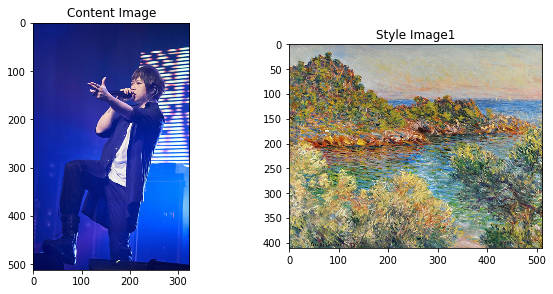

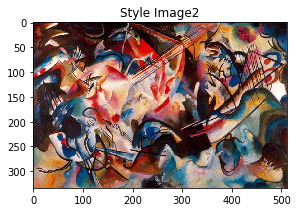

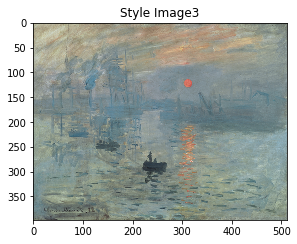

In [6]:
content_ashin = load_img(content_path_ashin)
style_1 = load_img(style_path_1)
style_2 = load_img(style_path_2)
style_3 = load_img(style_path_3)

plt.subplot(2, 2, 1)
imshow(content_ashin, 'Content Image')

plt.subplot(2, 2, 2)
imshow(style_1, 'Style Image1')
plt.show()

plt.subplot(2, 2, 3)
imshow(style_2, 'Style Image2')
plt.show()

plt.subplot(2, 2, 3)
imshow(style_3, 'Style Image3')
plt.show()

## Prepare Data

In [0]:
def load_and_process_img(path_to_img):
    img = load_img(path_to_img)
    img = tf.keras.applications.vgg19.preprocess_input(img)
    return img

In [0]:
def deprocess_img(processed_img):
  x = processed_img.copy()
  if len(x.shape) == 4:
    x = np.squeeze(x, 0)
  assert len(x.shape) == 3, ("Input to deprocess image must be an image of "
                             "dimension [1, height, width, channel] or [height, width, channel]")
  if len(x.shape) != 3:
    raise ValueError("Invalid input to deprocessing image")
  
  # perform the inverse of the preprocessing step
  x[:, :, 0] += 103.939
  x[:, :, 1] += 116.779
  x[:, :, 2] += 123.68
  x = x[:, :, ::-1]

  x = np.clip(x, 0, 255).astype('uint8')
  return x

In [0]:
def random_image(content_path,set_seed,pretrain):
    np.random.seed(set_seed)
    image= load_img(content_path)
    width = image.shape[2]
    height = image.shape[1]
    if pretrain =='resnet':
      rgb_array = np.random.rand(height,width,3) * 255
      img = Image.fromarray(rgb_array.astype('uint8')).convert('RGB')
      plt.subplot(1, 2, 1)
      plt.imshow(img)
      img = tf.keras.preprocessing.image.img_to_array(img)
      img = np.expand_dims(img, axis=0)
      img = tf.keras.applications.resnet50.preprocess_input(img)
    
    else:
      rgb_array = np.random.rand(height,width,3) * 255
      img = Image.fromarray(rgb_array.astype('uint8')).convert('RGB')
      plt.subplot(1, 2, 1)
      plt.imshow(img)
      img = np.stack([img]*1)
      img =tf.keras.applications.vgg19.preprocess_input(img)

    return img

In [0]:
def get_layers(pretrain,con_num, style_num):
  if pretrain == 'vgg':
    if con_num==1:
        ## basic case: 1 content and 5 style
        content_layers = ['block5_conv2'] 
        style_layers = ['block1_conv1',
                      'block2_conv1',
                      'block3_conv1', 
                      'block4_conv1', 
                      'block5_conv1'
               ]

    else:
      ## 2 content and 5 style
        content_layers = ['block4_conv4','block5_conv2' ]  
        style_layers = ['block1_conv1',
                      'block2_conv1',
                      'block3_conv1', 
                      'block4_conv1', 
                      'block5_conv1'
               ]
  ## resnet
  else:
    if con_num==1:
      if style_num ==5:
      ## basic case: 1 content and 5 style
        content_layers = ['conv5_block3_2_conv'] 
        style_layers = ['conv1_conv',
                'conv3_block3_3_conv',
                'conv3_block3_3_conv', 
                'conv4_block6_3_conv', 
                'conv5_block2_2_conv'
               ]
      ## 1content and more styles
      else:
        content_layers = ['conv5_block1_1_conv'] 

        style_layers = ['conv1_relu',
                        'conv2_block1_1_conv',
                        'conv2_block3_2_conv',
                        'conv3_block1_1_conv', 
                        'conv3_block3_3_conv',
                        'conv3_block3_3_conv', 
                        'conv4_block6_3_conv', 
                        'conv5_block2_2_conv'
                      ]


    else:
      if style_num==5:
      ## 1 content and 5 styles
        content_layers = ['conv5_block3_2_conv'] 
        style_layers = ['conv1_conv',
                'conv3_block3_3_conv',
                'conv3_block3_3_conv', 
                'conv4_block6_3_conv', 
                'conv5_block2_2_conv'
                ]

                
      else:
        ## 2 content and more styles
        content_layers = ['conv5_block3_2_conv','conv5_block3_2_conv'] 
        style_layers = ['conv1_conv',
                'conv3_block3_3_conv',
                'conv3_block3_3_conv', 
                'conv4_block6_3_conv', 
                'conv4_block6_3_conv',
                'conv5_block2_2_conv'
               ]

  num_content_layers = len(content_layers)
  num_style_layers = len(style_layers)            

  return content_layers, style_layers, num_content_layers, num_style_layers



## Model

In [0]:
def get_model(pretrain,con_num, style_num):
  """ Creates our model with access to intermediate layers. 
  
  This function will load the VGG19 model and access the intermediate layers. 
  These layers will then be used to create a new model that will take input image
  and return the outputs from these intermediate layers from the VGG model. 
  
  Returns:
    returns a keras model that takes image inputs and outputs the style and 
      content intermediate layers. 
  """
  content_layers, style_layers, num_content_layers,num_style_layers = get_layers(pretrain,con_num, style_num)

  if pretrain == 'vgg':
  # Load our model. We load pretrained VGG, trained on imagenet data
    model = tf.keras.applications.vgg19.VGG19(include_top=False, weights='imagenet', pooling = 'avg')
    model.trainable = False
    # Get output layers corresponding to style and content layers 
    style_outputs = [model.get_layer(name).output for name in style_layers]
    content_outputs = [model.get_layer(name).output for name in content_layers]
  else:
    # Load our model. We load pretrained VGG, trained on imagenet data
    model = tf.keras.applications.resnet.ResNet50(include_top=False, weights='imagenet', pooling = 'avg')
    model.trainable = False
    # Get output layers corresponding to style and content layers 
    style_outputs = [model.get_layer(name).output for name in style_layers]
    content_outputs = [model.get_layer(name).output for name in content_layers]

  model_outputs = style_outputs + content_outputs
  # Build model 
  return models.Model(model.input, model_outputs)

## Loss

In [0]:
def get_content_loss(base_content, target, method):
  if method == 'L1':
    return tf.reduce_mean(tf.math.abs(base_content - target)) 
  else:
    return tf.reduce_mean(0.5*tf.math.square(base_content - target))

In [0]:
def gram_matrix(input_tensor):
  # We make the image channels first 
  channels = int(input_tensor.shape[-1])
  a = tf.reshape(input_tensor, [-1, channels])
  gram = tf.matmul(a, a, transpose_a=True)
  return gram

def get_style_loss(base_style, gram_target):
  """Expects two images of dimension h, w, c"""
  # height, width, num filters of each layer
  # We scale the loss at a given layer by the size of the feature map and the number of filters
  height, width, channels = base_style.get_shape().as_list()
  gram_style = gram_matrix(base_style)
  
  return tf.reduce_mean(tf.square(gram_style - gram_target)) / (4. * (channels ** 2) * (width * height) ** 2)

In [0]:
def get_feature_representations(model, content_path, style_path, pretrain, con_num, style_num):
  # Load our images in 
  content_image = load_and_process_img(content_path)
  style_image = load_and_process_img(style_path)
  
  # batch compute content and style features
  style_outputs = model(style_image)
  content_outputs = model(content_image)
  
  content_layers, style_layers, num_content_layers,num_style_layers = get_layers(pretrain,con_num, style_num)
  
  # Get the style and content feature representations from our model  
  style_features = [style_layer[0] for style_layer in style_outputs[:num_style_layers]]
  content_features = [content_layer[0] for content_layer in content_outputs[num_style_layers:]]
  return style_features, content_features
  

In [0]:
def get_smooth_loss(base_list):
  total_loss = 0
  for x in base_list:
    a = tf.reduce_mean(tf.math.squared_difference(x[:,:,:-1,:], x[:,:,1:,:]))
    b = tf.reduce_mean(tf.math.squared_difference(x[:,:-1,:,:], x[:,1:,:,:]))
    total_loss += tf.reduce_mean(tf.math.pow(a+b,1))
  return total_loss / len(base_list)

In [0]:
def compute_loss(model, loss_weights, init_image, gram_style_features, content_features, method, style_layer_weight, pretrain, con_num, style_num):

  style_weight, content_weight, variation_weight = loss_weights
  
  # Feed our init image through our model. This will give us the content and 
  # style representations at our desired layers. Since we're using eager
  # our model is callable just like any other function!
  model_outputs = model(init_image)
  
  content_layers, style_layers, num_content_layers,num_style_layers = get_layers(pretrain,con_num, style_num)
  style_output_features = model_outputs[:num_style_layers]
  content_output_features = model_outputs[num_style_layers:]
  
  style_score = 0
  content_score = 0
  variation_score = 0

  # Accumulate style losses from all layers
  # Here, we equally weight each contribution of each loss layer

  if style_layer_weight == None:
    weight_per_style_layer = 1.0 / float(num_style_layers)
    for target_style, comb_style in zip(gram_style_features, style_output_features):
      style_score += weight_per_style_layer * get_style_loss(comb_style[0], target_style)
  else:
    for target_style, comb_style, i in zip(gram_style_features, style_output_features, range(num_style_layers)):
      weight_per_style_layer = style_layer_weight[i]
      style_score += weight_per_style_layer * get_style_loss(comb_style[0], target_style)

  # Accumulate content losses from all layers 
  weight_per_content_layer = 1.0 / float(num_content_layers)
  for target_content, comb_content in zip(content_features, content_output_features):
    content_score += weight_per_content_layer* get_content_loss(comb_content[0], target_content, method)
  
  # Total variation loss
  variation_score = get_smooth_loss([init_image])

  style_score *= style_weight
  content_score *= content_weight
  variation_score *= variation_weight

  # Get total loss
  loss = style_score + content_score + variation_score
  return loss, style_score, content_score, variation_score

In [0]:
def compute_grads(cfg):
  with tf.GradientTape() as tape: 
    all_loss = compute_loss(**cfg)
  # Compute gradients wrt input image
  total_loss = all_loss[0]
  return tape.gradient(total_loss, cfg['init_image']), all_loss

In [0]:
import IPython.display

def run_style_transfer(content_path, 
                       style_path,
                       method,
                       con_num =1,
                       style_num= 5,
                       pretrain= 'vgg',
                       setseed = 30,
                       style_layer_weight = None,
                       num_iterations=1500,
                       content_weight = 1e6, 
                       style_weight = 1e3,
                       variation_weight = 0,
                       learningrate=15): 
  # We don't need to (or want to) train any layers of our model, so we set their
  # trainable to false. 
  model = get_model(pretrain, con_num, style_num) 
  for layer in model.layers:
    layer.trainable = False
  
  # Get the style and content feature representations (from our specified intermediate layers) 
  style_features, content_features = get_feature_representations(model, content_path, style_path,pretrain, con_num, style_num)
  gram_style_features = [gram_matrix(style_feature) for style_feature in style_features]
  
  # Set initial image
  init_image = random_image(content_path,setseed,pretrain)
  init_image = tf.Variable(init_image, dtype=tf.float32)
  # Create our optimizer
  opt = tf.optimizers.Adam(learning_rate=learningrate, beta_1=0.99, epsilon=1e-1)

  # For displaying intermediate images 
  iter_count = 1
  
  # Store our best result
  best_loss, best_img = float('inf'), None
  
  # Create a nice config 
  loss_weights = (style_weight, content_weight, variation_weight)
  cfg = {
      'model': model,
      'loss_weights': loss_weights,
      'init_image': init_image,
      'gram_style_features': gram_style_features,
      'content_features': content_features,
      'method': method,
      'style_layer_weight': style_layer_weight,
      'pretrain':pretrain,
      'con_num': con_num,
      'style_num':style_num
  }
    
  # For displaying
  num_rows = 2
  num_cols = 5
  display_interval = num_iterations/(num_rows*num_cols)
  start_time = time.time()
  global_start = time.time()
  
  norm_means = np.array([103.939, 116.779, 123.68])
  min_vals = -norm_means
  max_vals = 255 - norm_means   
  
  imgs = []

  all_content_loss = []
  all_style_loss = []
  all_variation_loss= []
  all_all_loss = []

  for i in range(num_iterations):
    grads, all_loss = compute_grads(cfg)
    loss, style_score, content_score,variation_score = all_loss
    opt.apply_gradients([(grads, init_image)])
    clipped = tf.clip_by_value(init_image, min_vals, max_vals)
    init_image.assign(clipped)
    end_time = time.time() 


    all_content_loss.append(content_score)
    all_style_loss.append(style_score)
    all_variation_loss.append(variation_score)
    all_all_loss.append(loss)
    
    if loss < best_loss:
      # Update best loss and best image from total loss. 
      best_loss = loss
      best_img = deprocess_img(init_image.numpy())

    if i % display_interval== 0:
      start_time = time.time() 
      # Use the .numpy() method to get the concrete numpy array
      plot_img = init_image.numpy()
      plot_img = deprocess_img(plot_img)
      imgs.append(plot_img)
      IPython.display.clear_output(wait=True)
      IPython.display.display_png(Image.fromarray(plot_img))
      print('Iteration: {}'.format(i))        
      print('Total loss: {:.4e}, ' 
            'style loss: {:.4e}, '
            'content loss: {:.4e}, '
            'time: {:.4f}s'.format(loss, style_score, content_score, time.time() - start_time))
  print('Total time: {:.4f}s'.format(time.time() - global_start))
  IPython.display.clear_output(wait=True)
  plt.figure(figsize=(14,4))
  for i,img in enumerate(imgs):
      plt.subplot(num_rows,num_cols,i+1)
      plt.imshow(img)
      plt.xticks([])
      plt.yticks([])
      
  return best_img, best_loss, all_content_loss, all_style_loss, all_variation_loss, all_all_loss

In [0]:
def show_results(best_img, content_path, style_path, show_large_final=True):
  plt.figure(figsize=(10, 5))
  content = load_img(content_path) 
  style = load_img(style_path)

  plt.subplot(1, 2, 1)
  imshow(content, 'Content Image')

  plt.subplot(1, 2, 2)
  imshow(style, 'Style Image')

  if show_large_final: 
    plt.figure(figsize=(10, 10))

    plt.imshow(best_img)
    plt.axis('off')
    plt.title('Output Image')
    plt.show()

In [0]:
def plotloss(content, style, variation, allloss):
  fig, axs = plt.subplots(2, 2)
  axs[0, 0].plot(content)
  axs[0, 0].set_title('content loss')
  axs[0, 1].plot(style, 'tab:orange')
  axs[0, 1].set_title('style loss')
  axs[1, 0].plot(allloss, 'tab:green')
  axs[1, 0].set_title('total loss')
  axs[1, 1].plot(variation, 'tab:red')
  axs[1, 1].set_title('total variation loss')

  for ax in axs.flat:
      ax.set(xlabel='number of interation', ylabel='loss')

In [0]:
def random_style_layer_weights(pretrain, con_num, style_num=5, min = 0):
  content_layers, style_layers, num_content_layers,num_style_layers = get_layers(pretrain,con_num, style_num)
  max = num_style_layers
  a1 = np.random.uniform(min, max)
  a2 = np.random.uniform(min, max - a1) 
  a3 = np.random.uniform(min, max - a1 - a2) 
  a4 = np.random.uniform(min, max - a1 - a2 - a3) 
  a5 = (5 -a1 -a2 -a3 -a4) 
  nlist = [a1, a2, a3, a4, a5]
  w_list = [i / max for i in nlist]
  return(w_list)

# Train on one image

## L2


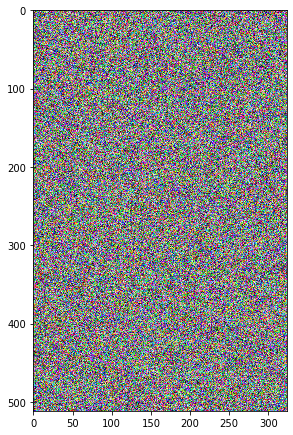

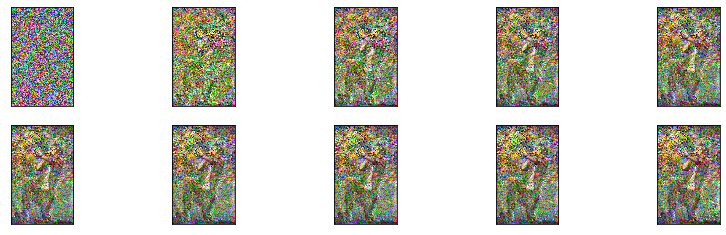

In [27]:
ashin_best_L2, ashin__best_loss_L2, ashin_content_loss_L2, ashin_style_loss_L2,ashin_variation_loss_L2,ashin_all_loss_L2 = run_style_transfer(content_path_ashin, 
                                     style_path_1, method='L2', 
                                     style_layer_weight = None, 
                                     content_weight=1e5, 
                                     style_weight = 1e3, 
                                     num_iterations=1500)

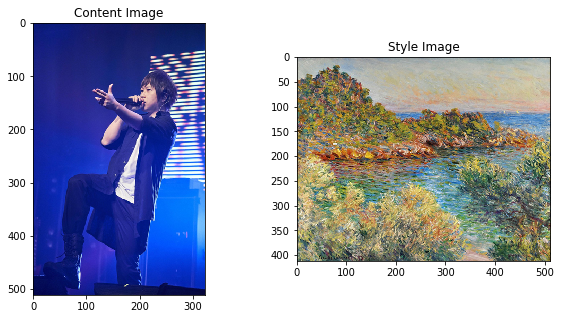

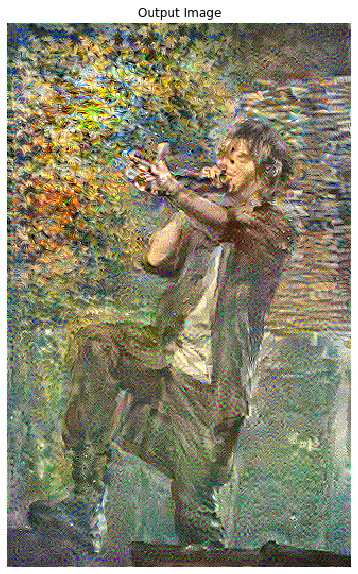

In [34]:
show_results(ashin_best_L2,content_path_ashin, style_path_1)

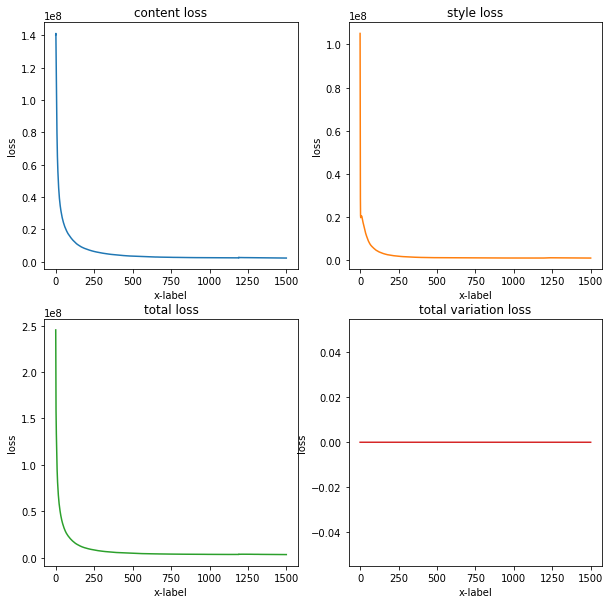

In [35]:
plotloss(ashin_content_loss_L2, ashin_style_loss_L2,ashin_variation_loss_L2,ashin_all_loss_L2)

## L1

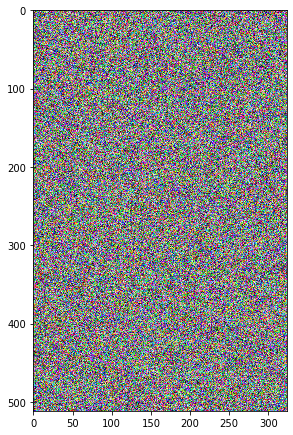

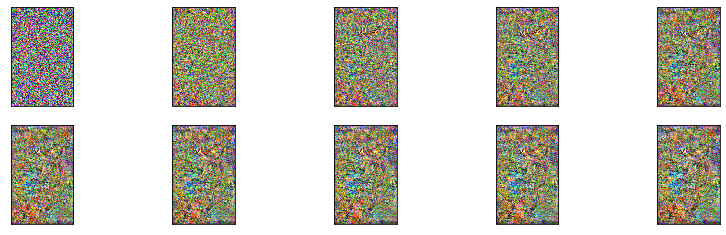

In [36]:
## Content_loss L1 without style_layer weight
ashin_best_L1, ashin__best_loss_L1, ashin_content_loss_L1, ashin_style_loss_L1,ashin_variation_loss_L1,ashin_all_loss_L1 = run_style_transfer(content_path_ashin, 
                                     style_path_1, method='L1', 
                                     style_layer_weight = None, 
                                     content_weight=1e5, 
                                     style_weight = 1e3, 
                                     num_iterations=1500)

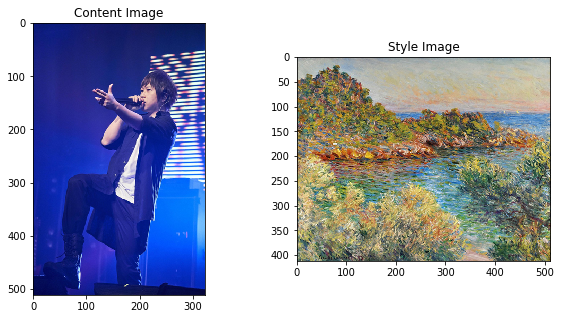

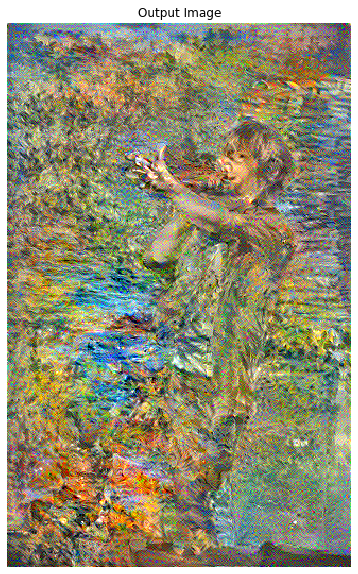

In [37]:
show_results(ashin_best_L1, content_path_ashin, style_path_1)

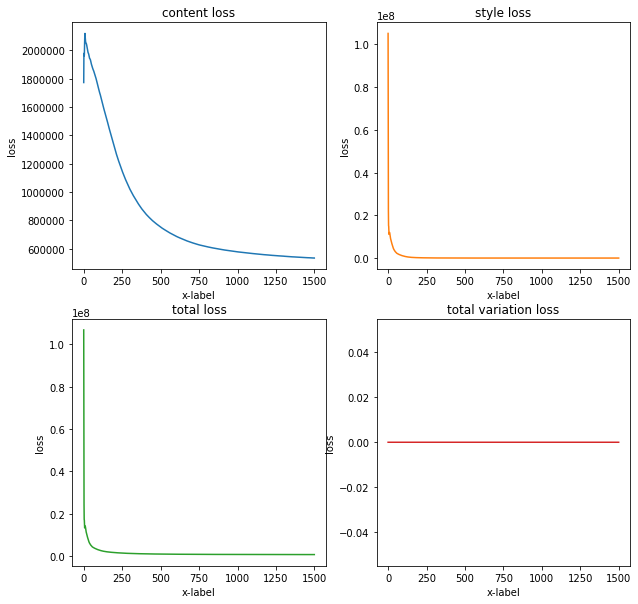

In [38]:
plotloss(ashin_content_loss_L1, ashin_style_loss_L1,ashin_variation_loss_L1,ashin_all_loss_L1)

## L2 with changing alpha and beta = 10


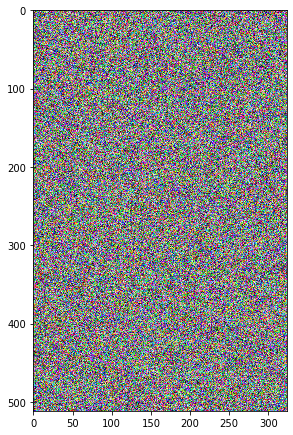

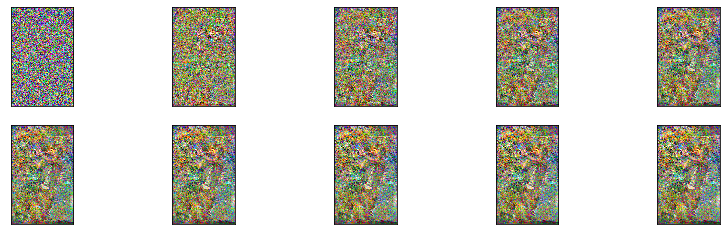

In [39]:

ashin_best_L2_wc, ashin__best_loss_L2_wc, ashin_content_loss_L2_wc, ashin_style_loss_L2_wc,ashin_variation_loss_L2_wc,ashin_all_loss_L2_wc = run_style_transfer(content_path_ashin, 
                                     style_path_1, method='L2', 
                                     style_layer_weight = None, 
                                     content_weight=1e4, 
                                     style_weight = 1e3, 
                                     num_iterations=1500)

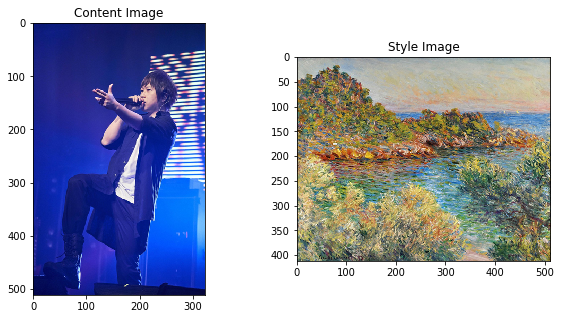

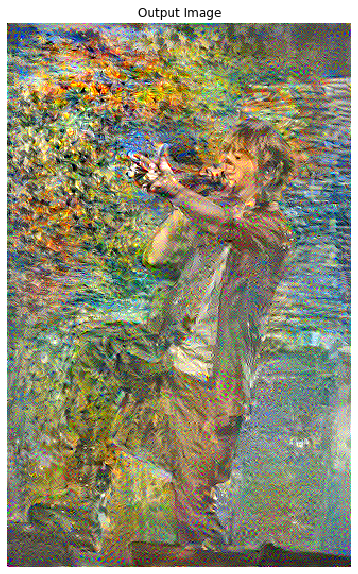

In [40]:
show_results(ashin_best_L2_wc, content_path_ashin, style_path_1)

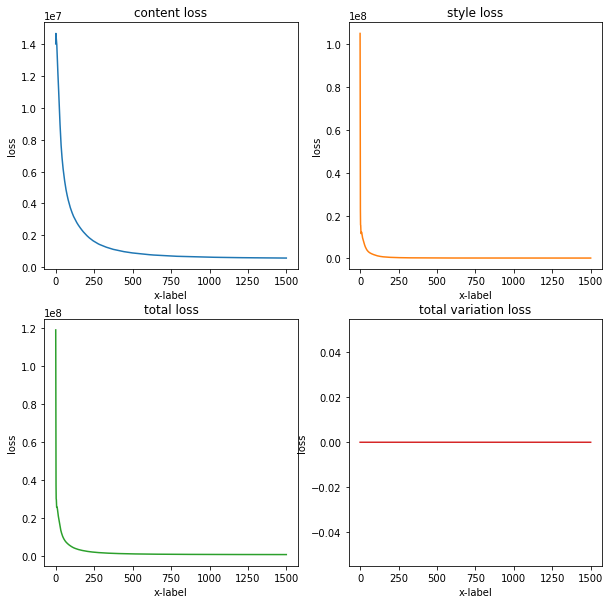

In [41]:
plotloss(ashin_content_loss_L2_wc, ashin_style_loss_L2_wc,ashin_variation_loss_L2_wc,ashin_all_loss_L2_wc)

##L2 with changing alpha and beta = 0.1

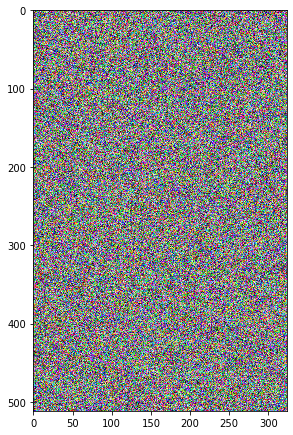

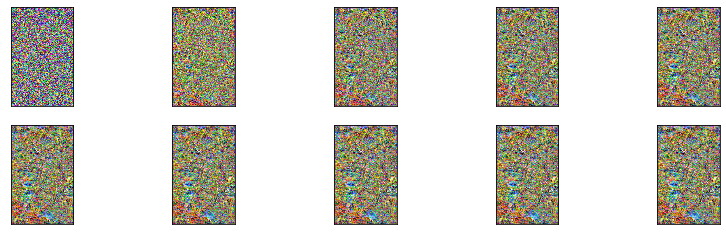

In [42]:
ashin_best_L2_wc, ashin__best_loss_L2_wc, ashin_content_loss_L2_wc, ashin_style_loss_L2_wc,ashin_variation_loss_L2_wc,ashin_all_loss_L2_wc = run_style_transfer(content_path_ashin, 
                                     style_path_1, method='L2', 
                                     style_layer_weight = None, 
                                     content_weight=1e2, 
                                     style_weight = 1e3, 
                                     num_iterations=1500)

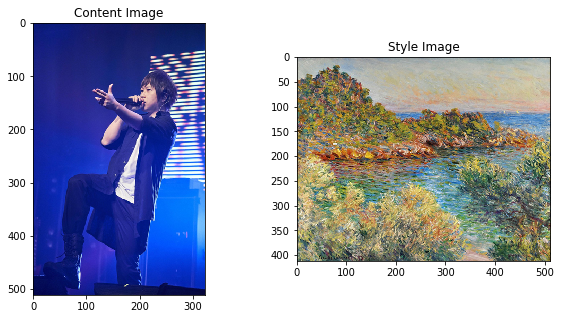

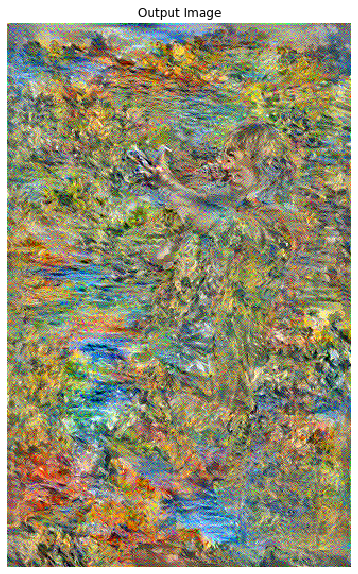

In [43]:
show_results(ashin_best_L2_wc, content_path_ashin, style_path_1)

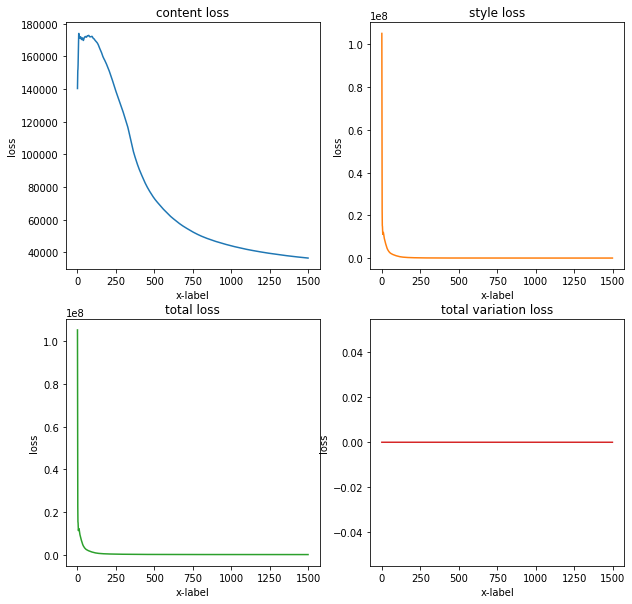

In [44]:
plotloss(ashin_content_loss_L2_wc, ashin_style_loss_L2_wc,ashin_variation_loss_L2_wc,ashin_all_loss_L2_wc)

## L2 with adding variation loss

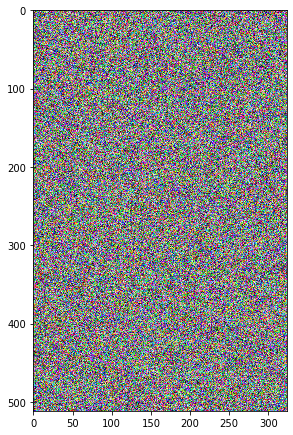

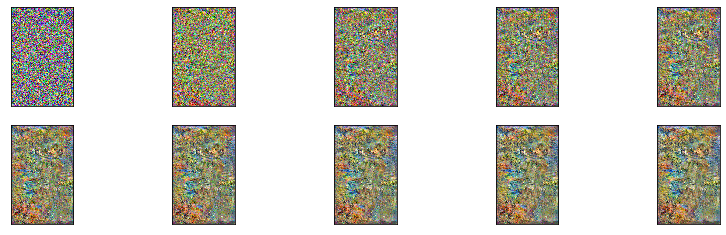

In [58]:

ashin_best_L2_wv, ashin__best_loss_L2_wv, ashin_content_loss_L2_wv, ashin_style_loss_L2_wv,ashin_variation_loss_L2_wv,ashin_all_loss_L2_wv = run_style_transfer(content_path_ashin, 
                                     style_path_1, method='L2', 
                                     style_layer_weight = None, 
                                     content_weight=1e3, 
                                     style_weight = 1e3, 
                                     variation_weight=10,
                                     num_iterations=1500)

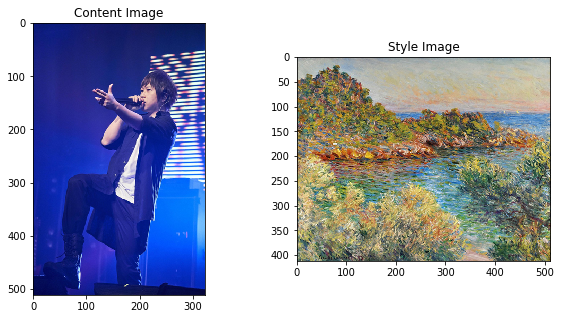

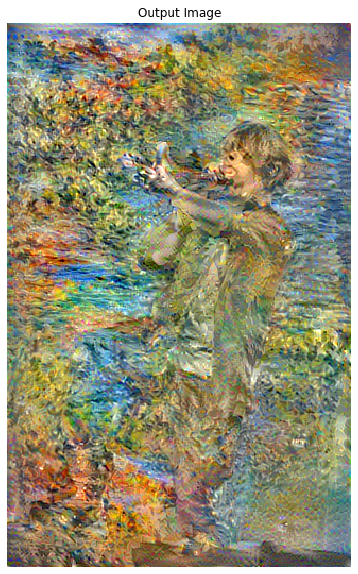

In [59]:
show_results(ashin_best_L2_wv, content_path_ashin, style_path_1)

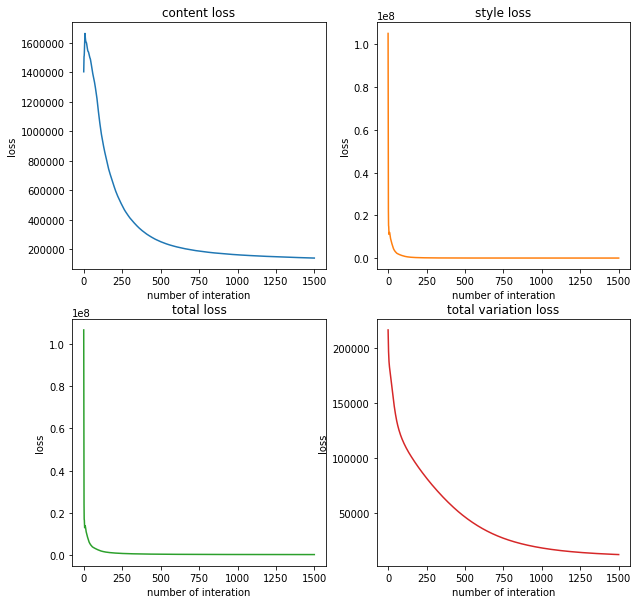

In [60]:
plotloss( ashin_content_loss_L2_wv, ashin_style_loss_L2_wv,ashin_variation_loss_L2_wv,ashin_all_loss_L2_wv)

## L2 with learning rate=5, change of iteration

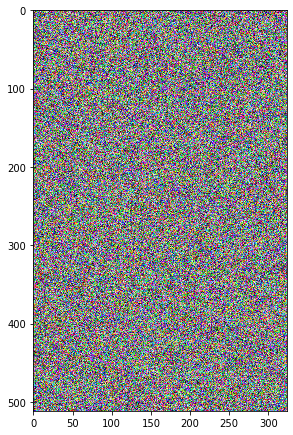

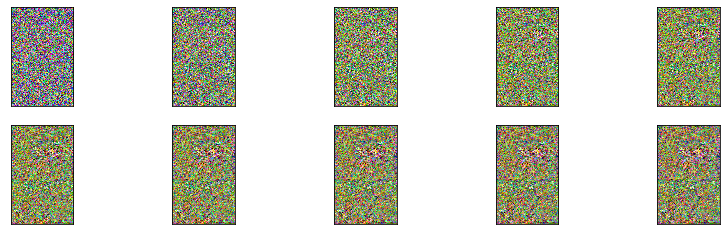

In [61]:
ashin_best_L2_lr, ashin__best_loss_L2_lr, ashin_content_loss_L2_lr, ashin_style_loss_L2_lr,ashin_variation_loss_L2_lr,ashin_all_loss_L2_lr = run_style_transfer(content_path_ashin, 
                                     style_path_1, method='L2', 
                                     style_layer_weight = None, 
                                     content_weight=1e4, 
                                     style_weight = 1e3, 
                                     variation_weight=10,
                                     learningrate=5,
                                     num_iterations=400)


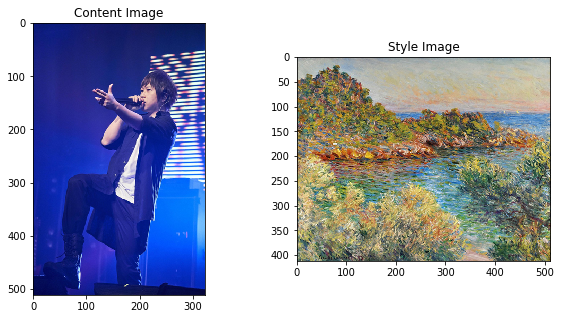

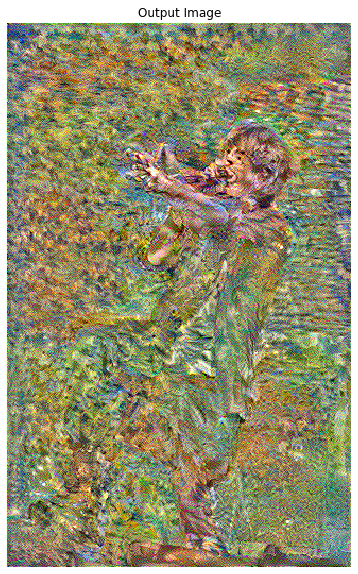

In [62]:
show_results(ashin_best_L2_lr, content_path_ashin, style_path_1)

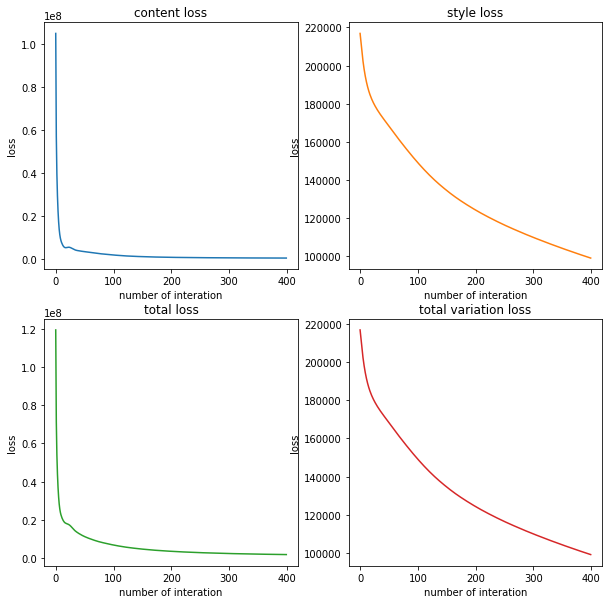

In [63]:
plotloss( ashin_style_loss_L2_lr,ashin_variation_loss_L2_lr,ashin_variation_loss_L2_lr,ashin_all_loss_L2_lr)

## L2 with random style layer weights

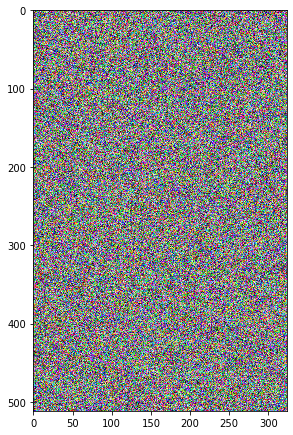

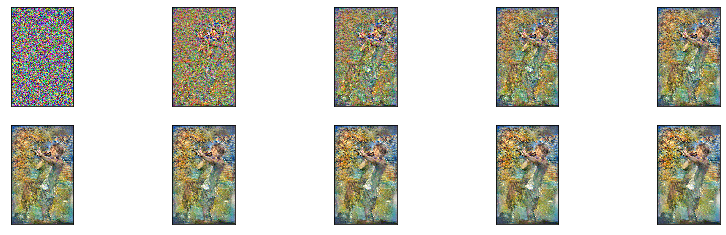

In [64]:
w = random_style_layer_weights(pretrain='vgg',con_num =1) 
ashin_best_L2_lw, ashin_best_loss_L2_lw, ashin_content_loss_L2_lw, ashin_style_loss_L2_lw, ashin_variation_loss_L2_lw,ashin_all_loss_L2_lw = run_style_transfer(content_path_ashin, 
                                    style_path_1, 
                                    method='L2', 
                                    style_layer_weight = w,
                                    content_weight=1e3, 
                                    style_weight = 1e3, 
                                    variation_weight=10,
                                    num_iterations=1500)

In [65]:
print(w)

[0.4909452174626393, 0.15392822371493192, 0.34832796640541586, 0.0011274521413939997, 0.005671140275618906]


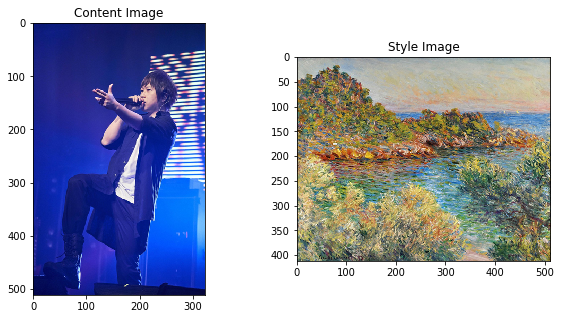

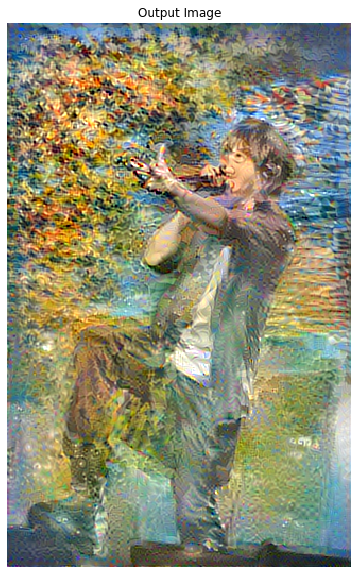

In [67]:
show_results(ashin_best_L2_lw, content_path_ashin, style_path_1)

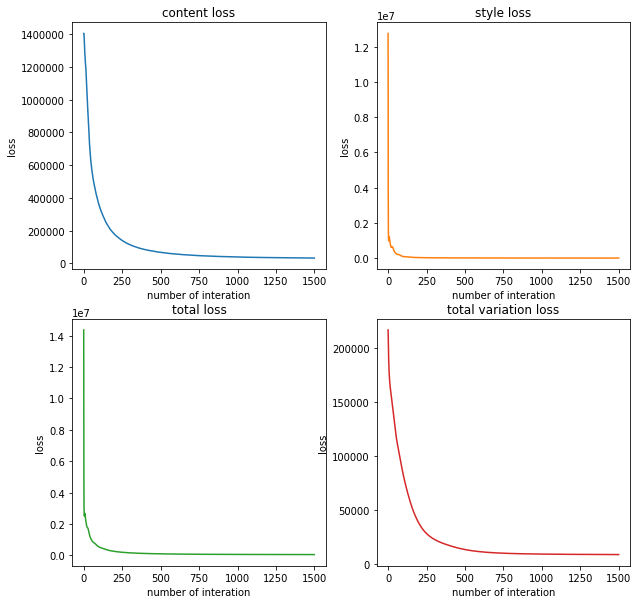

In [66]:
plotloss(ashin_content_loss_L2_lw, ashin_style_loss_L2_lw, ashin_variation_loss_L2_lw,ashin_all_loss_L2_lw)

## L2 with more layer weights on first two style layers

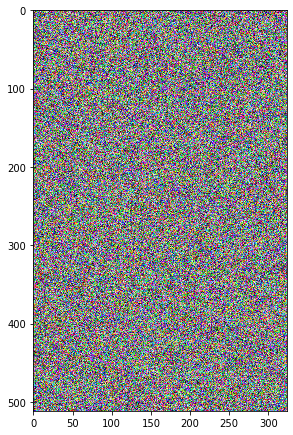

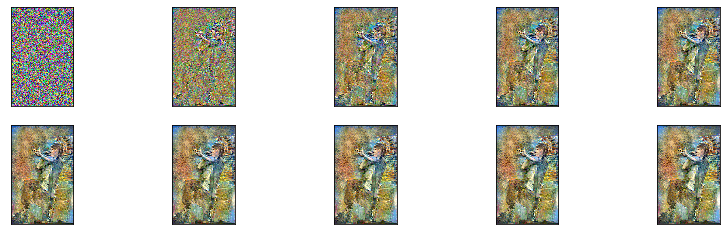

In [68]:
w = [1/2,1/2,0,0,0] 
ashin_best_L2_lw, ashin_best_loss_L2_lw, ashin_content_loss_L2_lw, ashin_style_loss_L2_lw, ashin_variation_loss_L2_lw,ashin_all_loss_L2_lw = run_style_transfer(content_path_ashin, 
                                    style_path_1, 
                                    method='L2', 
                                    style_layer_weight = w,
                                    content_weight=1e3, 
                                    style_weight = 1e3, 
                                    variation_weight=10,
                                    num_iterations=1500)

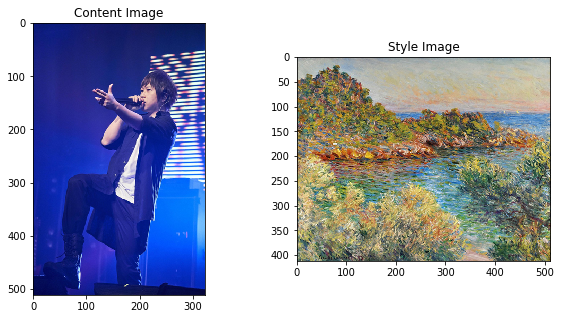

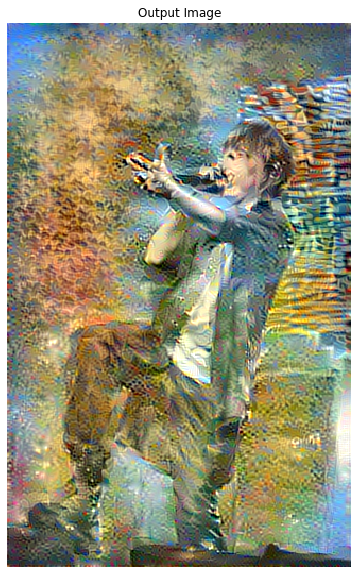

In [69]:
show_results(ashin_best_L2_lw, content_path_ashin, style_path_1)

## L2 with more layer weights on last two style layers

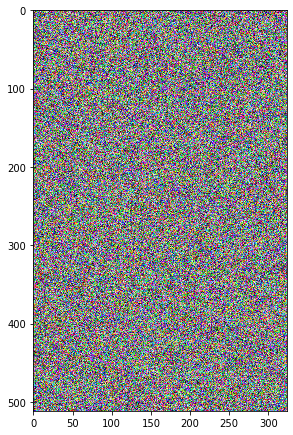

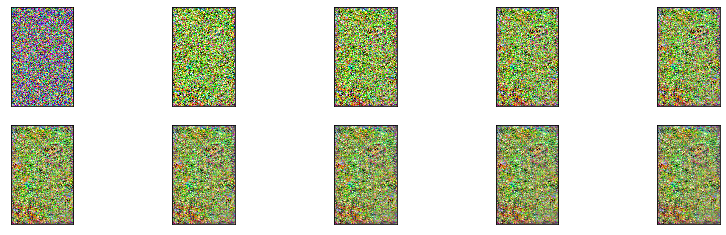

In [70]:
w = [0,0,0,1/2,1/2] 
ashin_best_L2_lw, ashin_best_loss_L2_lw, ashin_content_loss_L2_lw, ashin_style_loss_L2_lw, ashin_variation_loss_L2_lw,ashin_all_loss_L2_lw = run_style_transfer(content_path_ashin, 
                                    style_path_1, 
                                    method='L2', 
                                    style_layer_weight = w,
                                    content_weight=1e3, 
                                    style_weight = 1e3, 
                                    variation_weight=10,
                                    num_iterations=1500)

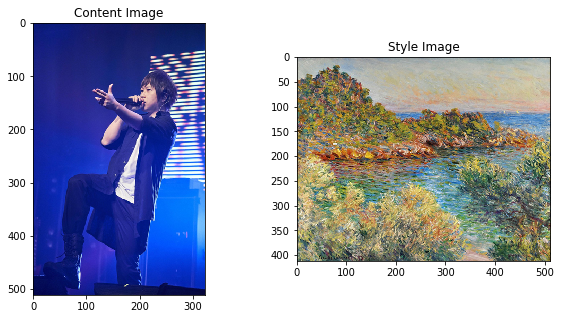

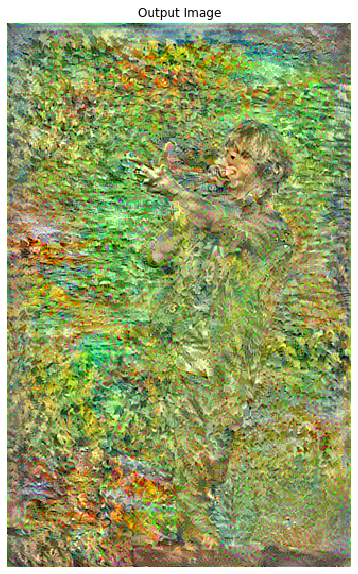

In [71]:
show_results(ashin_best_L2_lw, content_path_ashin, style_path_1)

## Changing seeds

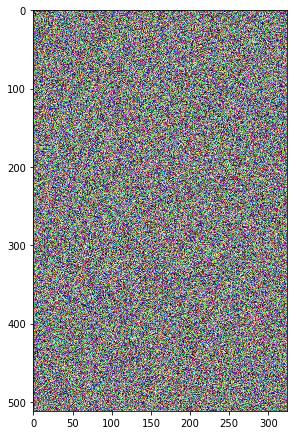

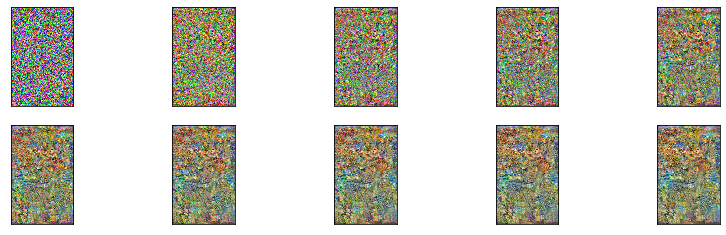

In [72]:
ashin_best_L2_seed, ashin__best_loss_L2_seed, ashin_content_loss_L2_seed, ashin_style_loss_L2_seed,ashin_variation_loss_L2_seed,ashin_all_loss_L2_seed = run_style_transfer(content_path_ashin, 
                                     style_path_1, method='L2', 
                                     style_layer_weight = None, 
                                     content_weight=1e3, 
                                     style_weight = 1e3, 
                                     variation_weight=10,
                                     setseed= 100,
                                     num_iterations = 1500)

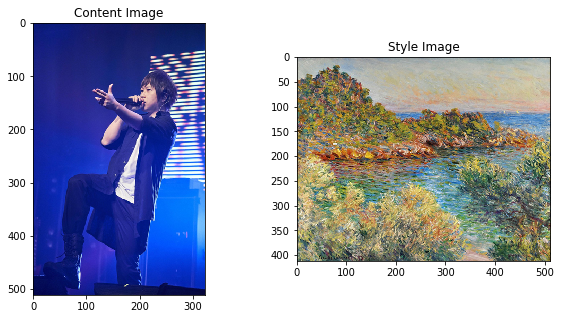

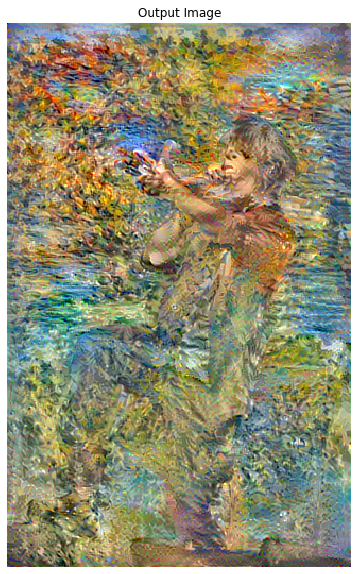

In [73]:
show_results(ashin_best_L2_seed, content_path_ashin, style_path_1)

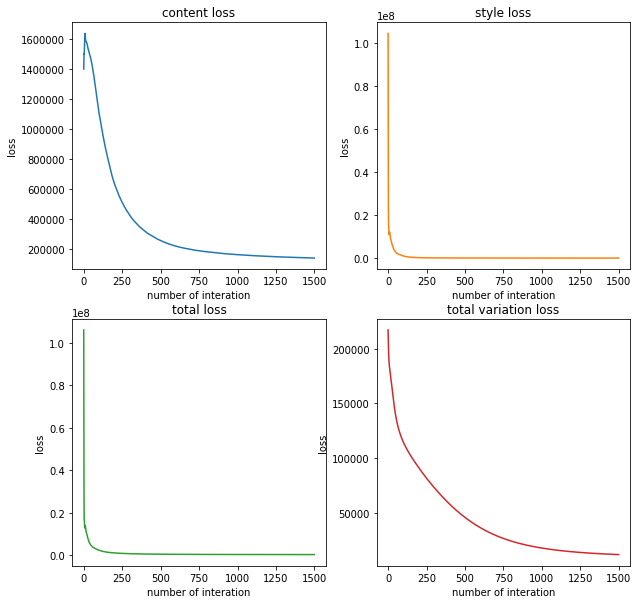

In [74]:
plotloss(ashin_content_loss_L2_seed, ashin_style_loss_L2_seed,ashin_variation_loss_L2_seed,ashin_all_loss_L2_seed)

## Change to resnet

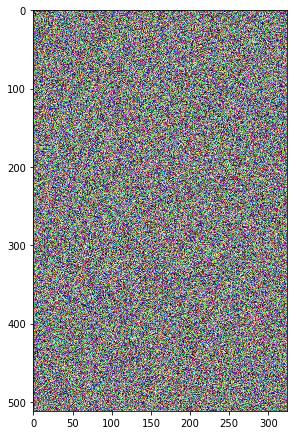

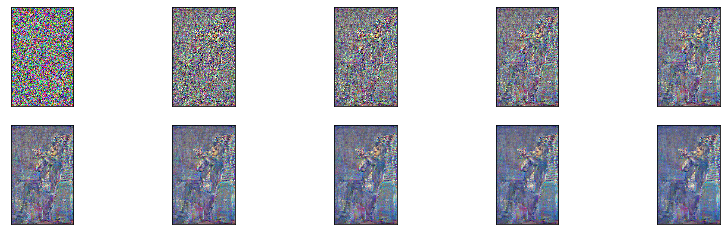

In [78]:
ashin_best_L1_res, ashin__best_loss_L1_res, ashin_content_loss_L1_res, ashin_style_loss_L1_res,ashin_variation_loss_L1_res,ashin_all_loss_L1_res = run_style_transfer(content_path_ashin, 
                                     style_path_1, method='L2', 
                                     style_layer_weight = None, 
                                     pretrain= 'resnet',
                                     style_num= 6,
                                     content_weight=1e6, 
                                     style_weight = 1e3, 
                                     variation_weight= 10,
                                     setseed= 100,
                                     num_iterations = 1500)

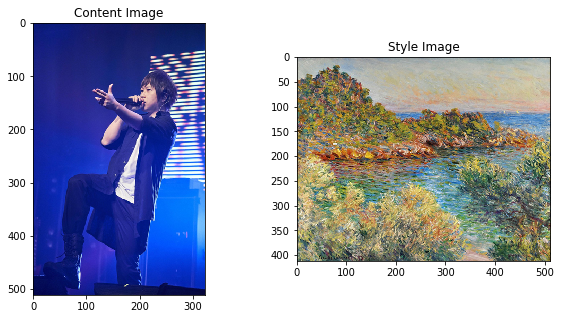

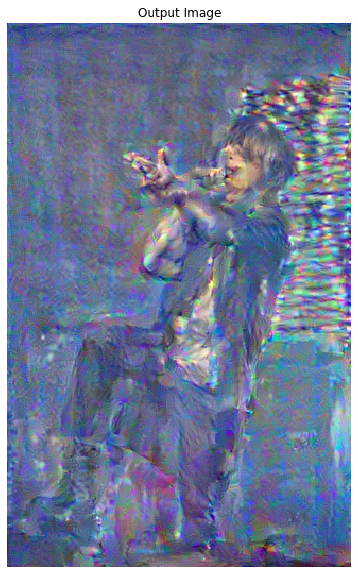

In [79]:
show_results(ashin_best_L1_res, content_path_ashin, style_path_1)

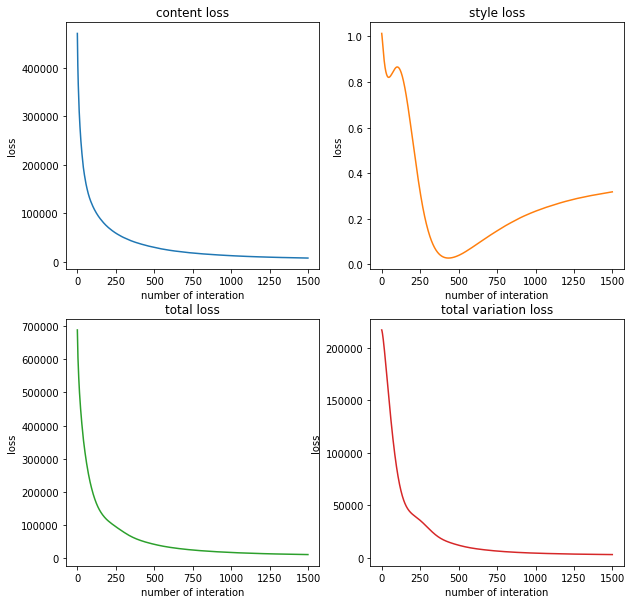

In [81]:
plotloss(ashin_content_loss_L1_res, ashin_style_loss_L1_res,ashin_variation_loss_L1_res,ashin_all_loss_L1_res)

## Change to two content layers

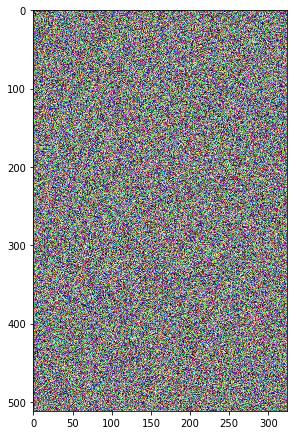

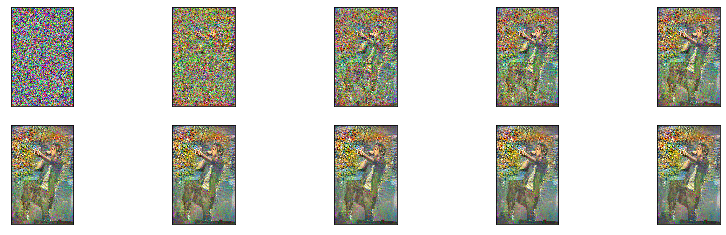

In [82]:
ashin_best_L2_2c, ashin__best_loss_L2_2c, ashin_content_loss_L2_2c, ashin_style_loss_L2_2c,ashin_variation_loss_L2_2c,ashin_all_loss_L2_2c = run_style_transfer(content_path_ashin, 
                                     style_path_1, method='L2', 
                                     style_layer_weight = None, 
                                     con_num =2,
                                     content_weight=1e3, 
                                     style_weight = 1e3, 
                                     variation_weight=10,
                                     setseed= 100,
                                     num_iterations = 1500)

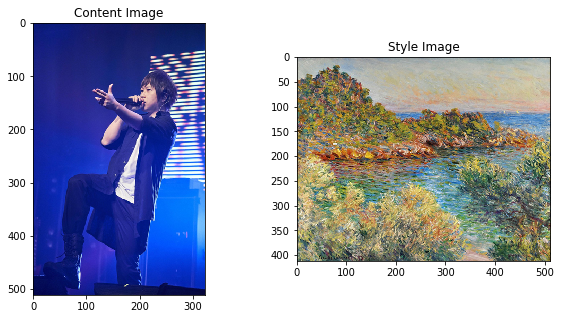

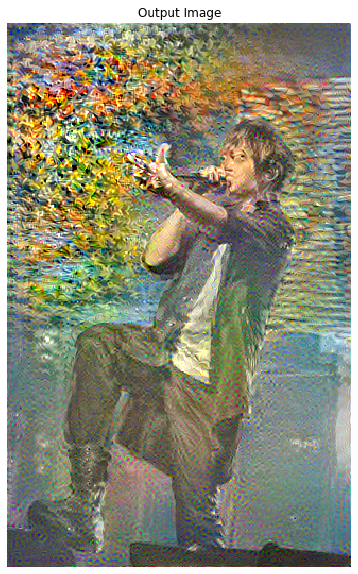

In [83]:
show_results(ashin_best_L2_2c,content_path_ashin, style_path_1)

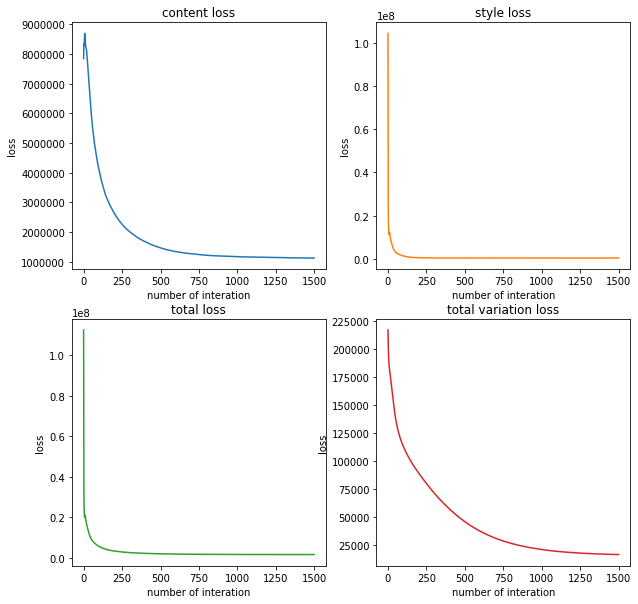

In [84]:
plotloss(ashin_content_loss_L2_2c, ashin_style_loss_L2_2c,ashin_variation_loss_L2_2c,ashin_all_loss_L2_2c)

## Test on images

### Trump **1**

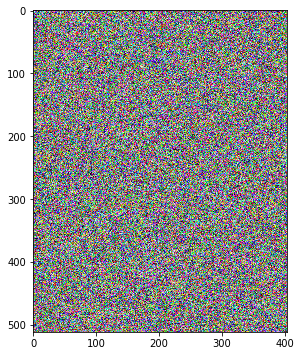

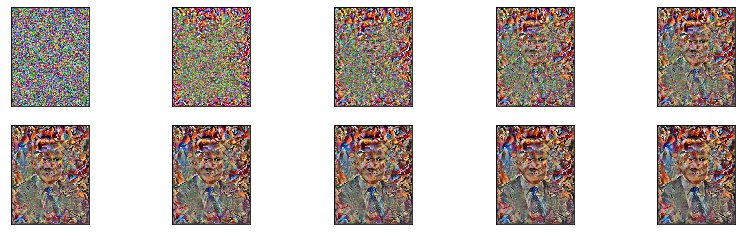

In [85]:
trump1_best_L2, trump1__best_loss_L2, trump1_content_loss_L2, trump1_style_loss_L2, trump1_variation_loss_L2, trump1_all_loss_L2 = run_style_transfer(
                                     content_path_trump, 
                                     style_path_2, method='L2', 
                                     style_layer_weight = None, 
                                     variation_weight = 10,
                                     content_weight=1e3, 
                                     style_weight = 1e3, 
                                     num_iterations=1500)

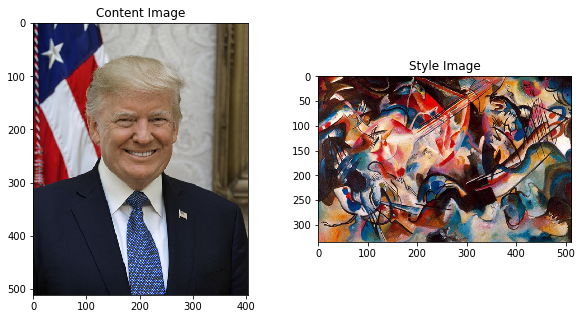

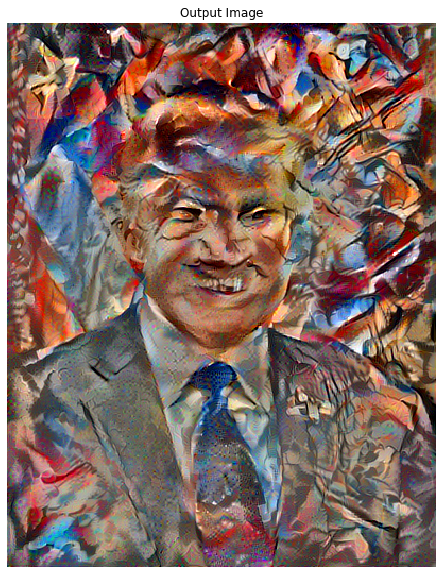

In [86]:
show_results(trump1_best_L2,content_path_trump, style_path_2)

### Trump2

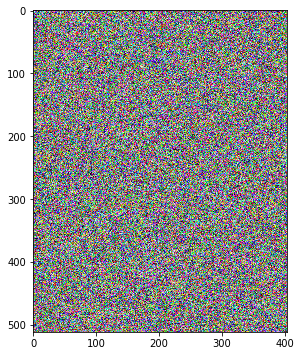

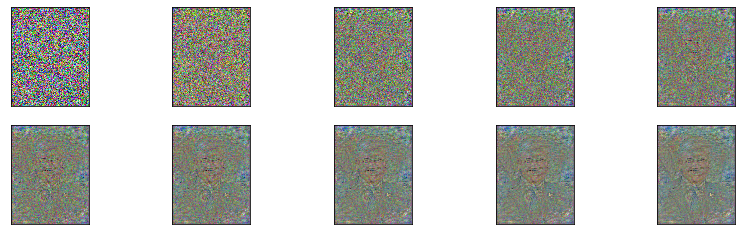

In [87]:
trump2_best_L2, trump2__best_loss_L2, trump2_content_loss_L2, trump2_style_loss_L2, trump2_variation_loss_L2, trump2_all_loss_L2 = run_style_transfer(
                                     content_path_trump,
                                     style_path_3, method='L2', 
                                     style_layer_weight = None, 
                                     variation_weight = 10,
                                     content_weight=1e2, 
                                     style_weight = 1e3, 
                                     num_iterations=1500)

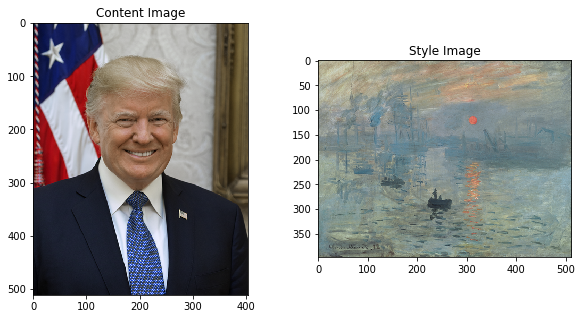

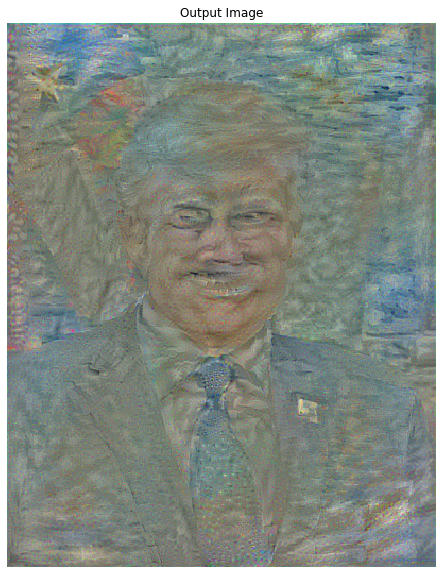

In [88]:
show_results(trump2_best_L2,content_path_trump, style_path_3)

### Elephant 1

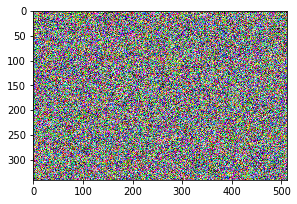

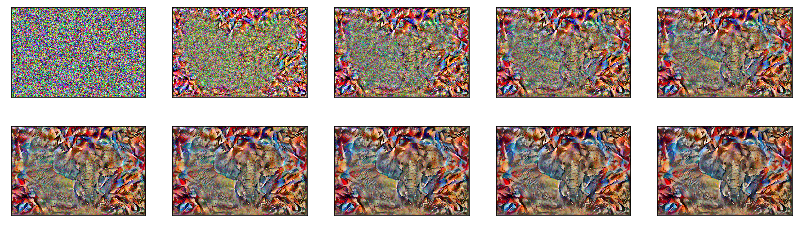

In [23]:
elephant1_best_L2, elephant1__best_loss_L2, elephant1_content_loss_L2, elephant1_style_loss_L2, elephant1_variation_loss_L2, elephant1_all_loss_L2 = run_style_transfer(
                                     content_path_elephant,
                                     style_path_2, method='L2', 
                                     style_layer_weight = None, 
                                     variation_weight = 10,
                                     content_weight=1e3, 
                                     style_weight = 1e3, 
                                     num_iterations=1500)

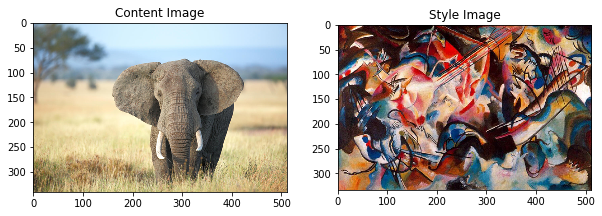

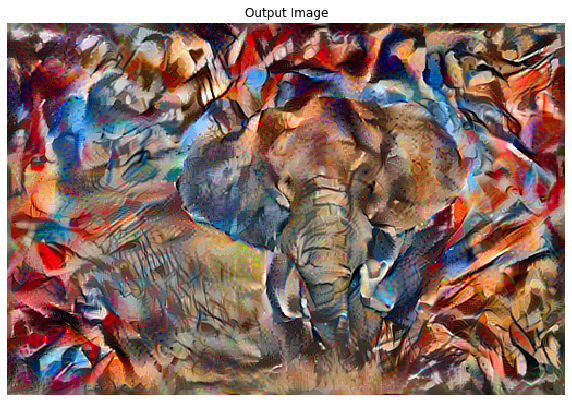

In [24]:
show_results(elephant1_best_L2, content_path_elephant, style_path_2)

### Elephant 2

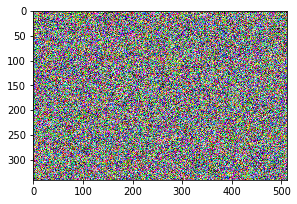

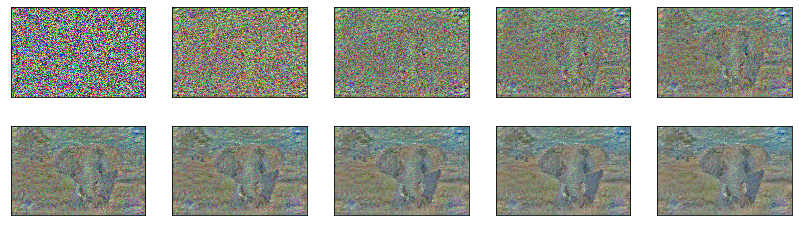

In [25]:
elephant2_best_L2, elephant2__best_loss_L2, elephant2_content_loss_L2, elephant2_style_loss_L2, elephant2_variation_loss_L2, elephant2_all_loss_L2 = run_style_transfer(
                                     content_path_elephant,
                                     style_path_3, method='L2', 
                                     style_layer_weight = None, 
                                     variation_weight = 10,
                                     content_weight=1e3, 
                                     style_weight = 1e3, 
                                     num_iterations=1500)

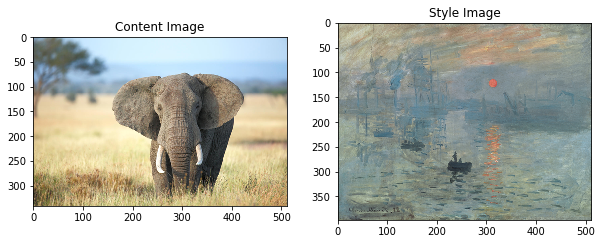

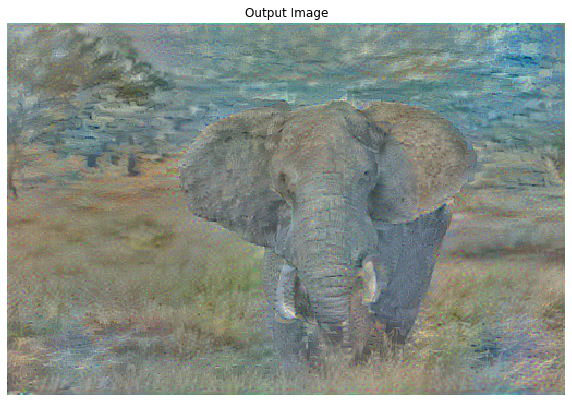

In [26]:
show_results(elephant2_best_L2, content_path_elephant, style_path_3)

## House1

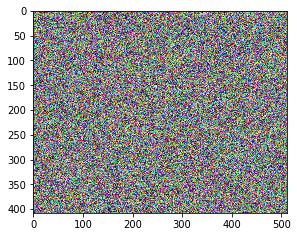

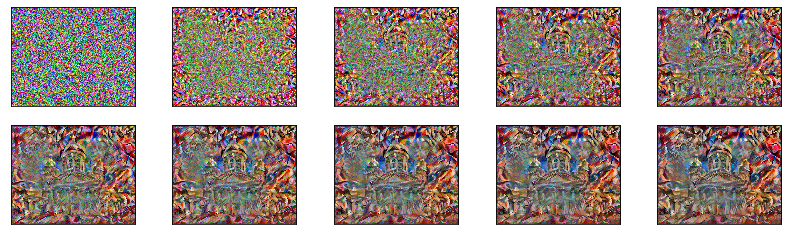

In [27]:
house1_best_L2, house1__best_loss_L2, house1_content_loss_L2, house1_style_loss_L2, house1_variation_loss_L2, house1_all_loss_L2 = run_style_transfer(
                                     content_path_house,
                                     style_path_2, method='L2', 
                                     style_layer_weight = None,
                                     variation_weight = 10, 
                                     content_weight=1e3, 
                                     style_weight = 1e3, 
                                     num_iterations=1500)

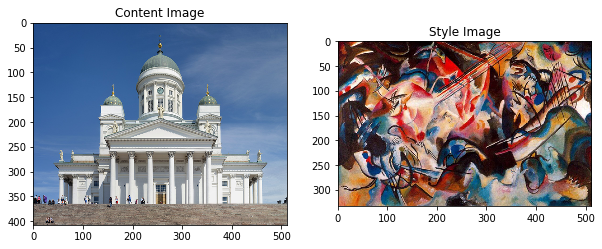

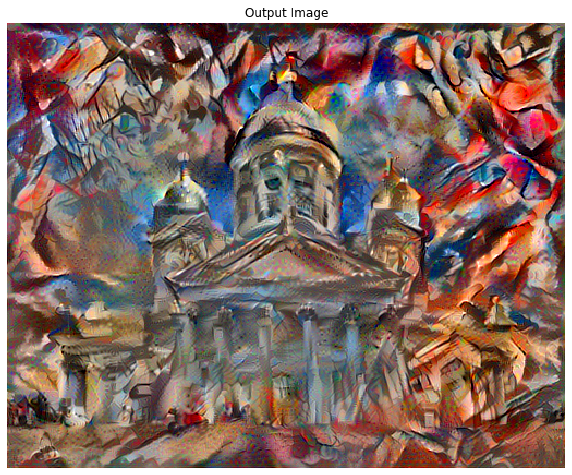

In [28]:
show_results(house1_best_L2, content_path_house, style_path_2)

## House2

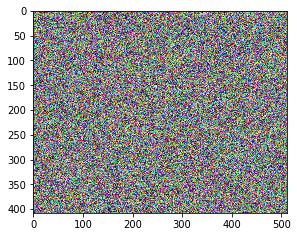

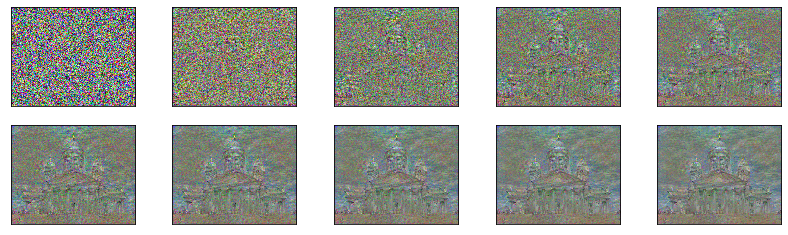

In [29]:
house2_best_L2, house2__best_loss_L2, house2_content_loss_L2, house2_style_loss_L2, house2_variation_loss_L2, house2_all_loss_L2 = run_style_transfer(
                                     content_path_house,
                                     style_path_3, method='L2', 
                                     style_layer_weight = None, 
                                     variation_weight = 10,
                                     content_weight=1e3, 
                                     style_weight = 1e3, 
                                     num_iterations=1500)

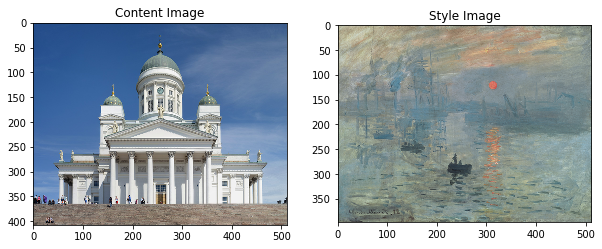

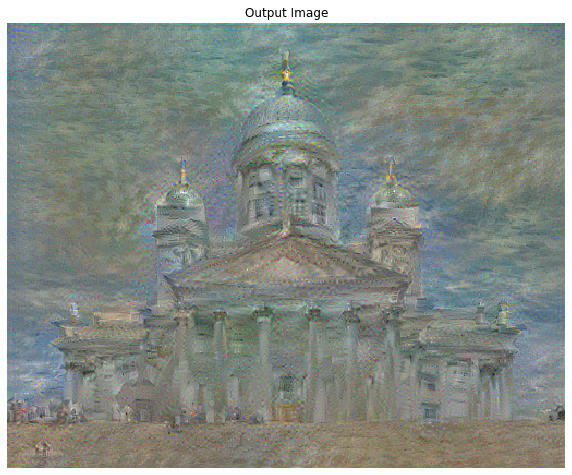

In [30]:
show_results(house2_best_L2, content_path_house, style_path_3)